In [1]:
#Imports
import warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from tqdm import tqdm
from sklearn import cluster
from sklearn.preprocessing import StandardScaler 
from pygsp import graphs, filters
import scipy.sparse.csgraph
from scipy.sparse import csr_matrix
from sklearn import manifold
import seaborn as sns


warnings.filterwarnings('ignore')
%matplotlib inline

# 1. Preprocessing the data: 

## 1.1 Loading the dataset : 

In [2]:
#Loading the dataframe.
df = pd.read_csv('./Table_Ciqual_2016.csv',delimiter=';',encoding='latin-1')
#Showing the first 10 rows of the dataframe.
df.head(10)

,ORIGGPCD,ORIGGPFR,ORIGFDCD,ORIGFDNM,"Energie, Règlement UE N° 1169/2011 (kJ/100g)","Energie, Règlement UE N° 1169/2011 (kcal/100g)","Energie, N x facteur Jones, avec fibres (kJ/100g)","Energie, N x facteur Jones, avec fibres (kcal/100g)",Eau (g/100g),Protéines (g/100g),...,Vitamine K1 (µg/100g),Vitamine K2 (µg/100g),Vitamine C (mg/100g),Vitamine B1 ou Thiamine (mg/100g),Vitamine B2 ou Riboflavine (mg/100g),Vitamine B3 ou PP ou Niacine (mg/100g),Vitamine B5 ou Acide pantothénique (mg/100g),Vitamine B6 (mg/100g),Vitamine B9 ou Folates totaux (µg/100g),Vitamine B12 (µg/100g)
0,1.1,Farines et amidons,4090,Fécule de pomme de terre,1480,348,1480,348,12.7,0,...,-,-,0,0.0055,0.005,0.12,-,0.01,82,0
1,1.1,Farines et amidons,9311,Flocon d'avoine,1550,367,1530,364,10.1,13.3,...,2,-,0,0.43,0.14,0.96,1.31,0.12,39.6,0
2,1.1,Farines et amidons,9410,Farine de blé tendre ou froment T110,1490,351,1470,348,9.96,10.3,...,16,-,< 0.5,0.41,0.083,2.45,0.6,0.17,37.3,0
3,1.1,Farines et amidons,9415,Farine de blé tendre ou froment T150,1430,338,1410,334,10.7,11.4,...,-,-,< 0.5,0.34,0.11,3.48,1.02,0.26,52.4,-
4,1.1,Farines et amidons,9435,Farine de blé tendre ou froment T65,1460,345,1440,341,13.2,12.6,...,-,-,-,0.19,0.05,1.46,0.5,0.08,18.3,-
5,1.1,Farines et amidons,9436,Farine de blé tendre ou froment T55 (pour pains),1470,348,1460,344,13.6,10.4,...,0.3,-,0,0.12,0.05,1.16,0.49,0.054,24.7,0
6,1.1,Farines et amidons,9437,Farine de blé tendre ou froment avec levure in...,1490,350,1470,346,-,9.12,...,-,-,-,-,-,-,-,-,-,-
7,1.1,Farines et amidons,9440,Farine de blé tendre ou froment T45 (pour pâti...,1490,351,1480,348,11.3,9.06,...,0,-,0,0.12,0.031,0.89,0.84,0.06,18,0
8,1.1,Farines et amidons,9445,Farine de blé tendre ou froment T80,1510,355,1490,352,10.7,9.95,...,-,-,< 0.5,0.26,0.06,1.5,0.5,0.13,53.8,-
9,1.1,Farines et amidons,9510,Amidon de maïs ou fécule de maïs,1550,364,1550,364,8.73,0.43,...,0,-,0,0,0.008,0.03,0,0.005,1,0


## 1.2 Features categorization : 

In [3]:
fats = ['AG 10:0, caprique (g/100g)', 'AG 12:0, laurique (g/100g)',
       'AG 14:0, myristique (g/100g)', 'AG 16:0, palmitique (g/100g)',
       'AG 18:0, stéarique (g/100g)', 'AG 18:1 9c (n-9), oléique (g/100g)',
       'AG 18:2 9c,12c (n-6), linoléique (g/100g)',
       'AG 18:3 c9,c12,c15 (n-3), alpha-linolénique (g/100g)',
       'AG 20:4 5c,8c,11c,14c (n-6), arachidonique (g/100g)',
       'AG 20:5 5c,8c,11c,14c,17c (n-3) EPA (g/100g)',
       'AG 22:6 4c,7c,10c,13c,16c,19c (n-3) DHA (g/100g)',
       'AG 4:0, butyrique (g/100g)', 'AG 6:0, caproïque (g/100g)',
       'AG 8:0, caprylique (g/100g)', 'AG monoinsaturés (g/100g)',
       'AG polyinsaturés (g/100g)', 'AG saturés (g/100g)','Lipides (g/100g)',
           'Cholestérol (mg/100g)']
minerals = ['Calcium (mg/100g)','Cuivre (mg/100g)',
            'Magnésium (mg/100g)','Iode (µg/100g)',
            'Manganèse (mg/100g)','Phosphore (mg/100g)',
            'Potassium (mg/100g)','Sélénium (µg/100g)',
            'Zinc (mg/100g)','Sodium (mg/100g)','Fer (mg/100g)','Chlorure (mg/100g)']

calories = ['Energie, N x facteur Jones, avec fibres  (kJ/100g)',
       'Energie, N x facteur Jones, avec fibres  (kcal/100g)',
       'Energie, Règlement UE N° 1169/2011 (kJ/100g)',
       'Energie, Règlement UE N° 1169/2011 (kcal/100g)']

B_vitamins = ['Vitamine B1 ou Thiamine (mg/100g)', 'Vitamine B12 (µg/100g)',
       'Vitamine B2 ou Riboflavine (mg/100g)',
       'Vitamine B3 ou PP ou Niacine (mg/100g)',
       'Vitamine B5 ou Acide pantothénique (mg/100g)',
              'Vitamine B6 (mg/100g)','Vitamine B9 ou Folates totaux (µg/100g)'] #Note : Vitamin B12 comes only from animal products or unfiltered water or fortified foods...
other_vitamins = ['Vitamine C (mg/100g)', 'Vitamine D (µg/100g)',
       'Vitamine E (mg/100g)', 'Vitamine K1 (µg/100g)',
       'Vitamine K2 (µg/100g)','Beta-Carotène (µg/100g)']
carbs = ['Amidon (g/100g)','Glucides (g/100g)','Fibres alimentaires (g/100g)','Sucres (g/100g)']
alcohols = ['Rétinol (µg/100g)','Polyols totaux (g/100g)','Alcool (g/100g)']
proteins = ['Protéines (g/100g)', 'Protéines brutes, N x 6.25 (g/100g)']
others = ['Sel chlorure de sodium (g/100g)','Eau (g/100g)','Cendres (g/100g)','Acides organiques (g/100g)']
categories = ['ORIGGPCD','ORIGGPFR']
food_names = ['ORIGFDCD','ORIGFDNM']

assert(set(df.columns)==set(food_names+categories+others+proteins+alcohols+carbs+other_vitamins+B_vitamins+calories+minerals+fats))

The missing values are put as '-' in the dataframe, also some of the values are marked as <(some number) which we will set to 0 , as it implies that the value is negligeable.

## 1.3 Rearranging categories : 

The column named ORIGGPCD contains the ids of a category and sub-category of a certain food which we will need later in this project. <br>However, we noticed that these categories are not very well done after exploring the dataset. So, we decided that it is best to rearrange the categories into ones that should give us better results. 
<br>Also, some products are composed products, such as, soups with grains and vegetables, or plates ready to be microwaved. These foods can affect our later manipulations and analysis negatively. That is why, we decided to remove these from the dataframe.

In [4]:
#Rearranging categories by category id
starch_flour = [1.1,1.3]
grains = [1.2,1.4,1.5]
breads = [2.1,2.2,2.3,2.4,3.6,25.4]
sugary_biscuits_cakes = [3.1,3.2,21.4]
salty_biscuits_cakes = [3.3,3.5]
cereals = [4.1,4.2,4.3,4.4,4.5,4.6,4.7,4.8,4.9]
milk = [5.0,5.1,5.3,5.4,5.6]
cheese = [6.1,5.5,6.3,6.5,6.6,6.8,6.9,25.5]
eggs=[7.1,7.2,7.3]
oils_and_oil_like=[8.1,8.2,8.3,8.4,8.5,8.6]
meat = [9]
chicken = [10]
processed_meats = [12.1,12.2,12.3,12.4,12.5,12.6,12.7,12.8]
fish = [13.1,13.2,13.3,13.4,13.5,13.6,25.2]
sea_foods = [14.1,14.2,14.3,14.4,25.7]
vegetables = [15.1,15.2,15.3,16.1,16.2,16.3,25.3]
legumes = [16.1,16.2,16.3]
fruits = [18.1,18.2]
non_alcoholic_drinks = [19,19.1,19.2,22.1,22.3,22.4,22.5,22.6,22.7,36]
nuts = [20]
sweeteners=[21.1,18.4,18.5]
alcoholic_drinks = [23.1,23.2,23.3,23.4,23.5]
spices = [28,28.1,28.2,28.7]
#complements = [31]
ice_creams = [32.1,32.2,32.3]
algae = [34.1,34.2]
all_categories = [algae,ice_creams,spices,
                  alcoholic_drinks,sweeteners,nuts,fruits,
                  non_alcoholic_drinks,
                  vegetables,sea_foods,fish,processed_meats, 
                  chicken,meat,starch_flour,grains, breads ,
                  sugary_biscuits_cakes ,salty_biscuits_cakes ,
                  cereals ,milk, cheese, eggs, oils_and_oil_like ]

#Selecting ids of categories of foods that will be removed. 
remove = [5.7,5.9,11,25.1,7.3,31,17,3.4,18.3,18.6,22.2,24,25,26,27.1,27.2,27.9,28.3,29,30,33.1,28.9,33.2,33.3,33.4,33.5,35,5.8,21.3,25.6,25.9,28.8,28.6]

#Giving names to the given categories for later use. 
category_names=["Algae","Ice creams","Spices","Alcoholic Beverages","Sweeteners","Nuts","Fruits","Non-Alcoholic Beverages",
                "Vegetables","Sea foods","Fish","Processed meats","Poultry","Meat",
                "Starch and Flours","Grains","Breads","Sugary biscuits and cakes","Salty biscuits and cakes","Cereals","Milk",
                "Cheeses","Egg products","Oils and oil like"]

#Basic assertions to test correctness.
assert(len(all_categories)==24)
assert(len(category_names)==len(all_categories))

Here we will store the given categories indices to the dataframe and remove the elements added to remove array.

In [5]:
def return_cat(categories,row):
    """
    Returns category of food at row position given by parameter row.
    :param categories: list
    :param row: int
    :return: int
    """
    for i in range(len(categories)): 
        for j in categories[i] : 
            if(row==j) : return i+1
    return 0

In [6]:
#Removing composed foods.
for i in remove :     
    df=df[df['ORIGGPCD'] !=i]
    
#Adding cat columns which contain id of given category.
df['cat'] = pd.Series(np.zeros(len(df)))
df['cat'] = df['ORIGGPCD'].apply(lambda x : return_cat(all_categories,x) )
df = df.reset_index(drop = True)

## 1.4 Cleaning the dataset :

Here, we will fill all missing values with zeros because all missing values are marked as '-' or '<(float)' or 'trace'. This will be shown later. 

In [7]:
#A list to keep track of values that couldn't be converted to a float
special_values=[]

def cleanup(food, columns) : 
    """
    Returns vector with columns provided in parameter columns and float values.
    :param food: list
    :param columns: list of strings
    :return: DataFrame with float values
    """
    vector = food[columns] 
    for i in columns : 
        #Skip columns with text.
        if(i in ['ORIGFDNM','ORIGGPFR']) : continue
        #convert string values to float.
        try : 
            vector[i]=float(vector[i])
        #If that is not possible set it to 0.
        except ValueError : 
            #Kepping track of characters that will be assigned 0.
            special_values.append(vector[i])
            vector[i]=0
    return vector

In [8]:
#Selecting columns that we will keep for our graph. 

columns= ['ORIGFDNM','ORIGGPFR', #These columns (ORIGFDNM and ORIGGPFR) are kept for later use. But they won't affect the computations to come.
          'Protéines (g/100g)','Glucides (g/100g)','Lipides (g/100g)',
          'Fibres alimentaires (g/100g)','Sucres (g/100g)',
          'AG saturés (g/100g)','Cholestérol (mg/100g)',
          'Alcool (g/100g)',
          'Sel chlorure de sodium (g/100g)',
          'Calcium (mg/100g)',
          'Chlorure (mg/100g)',
          'Cuivre (mg/100g)',
          'Fer (mg/100g)',
          'Iode (µg/100g)',
          'Magnésium (mg/100g)',
          'Manganèse (mg/100g)',
          'Phosphore (mg/100g)',
          'Potassium (mg/100g)',
          'Sélénium (µg/100g)',
          'Sodium (mg/100g)',
          'Zinc (mg/100g)',
          'Rétinol (µg/100g)',
          'Beta-Carotène (µg/100g)',
          'Vitamine D (µg/100g)',
          'Vitamine E (mg/100g)',
          'Vitamine K1 (µg/100g)',
          'Vitamine K2 (µg/100g)',
          'Vitamine C (mg/100g)',
          'Vitamine B1 ou Thiamine (mg/100g)',
          'Vitamine B2 ou Riboflavine (mg/100g)',
          'Vitamine B3 ou PP ou Niacine (mg/100g)',
          'Vitamine B5 ou Acide pantothénique (mg/100g)',
          'Vitamine B6 (mg/100g)',
          'Vitamine B9 ou Folates totaux (µg/100g)',
          'Vitamine B12 (µg/100g)']

In [9]:
#The vector is still in dataframe form.
df=df.apply(lambda x : cleanup(x,df.columns),axis=1)
vectors=df.apply(lambda x : cleanup(x,columns),axis=1)


In [10]:
#Checking the special characters that were set to 0. 
print(np.unique(special_values))

['-' '< 0.00001' '< 0.00002' '< 0.000056' '< 0.00008' '< 0.0001'
 '< 0.00018' '< 0.0002' '< 0.00021' '< 0.00022' '< 0.00024' '< 0.00027'
 '< 0.00028' '< 0.0003' '< 0.0004' '< 0.00044' '< 0.0005' '< 0.00056'
 '< 0.00057' '< 0.00066' '< 0.00071' '< 0.00076' '< 0.00077' '< 0.0008'
 '< 0.00082' '< 0.00083' '< 0.00092' '< 0.001' '< 0.0011' '< 0.0012'
 '< 0.0013' '< 0.0014' '< 0.0015' '< 0.0016' '< 0.0018' '< 0.0019'
 '< 0.002' '< 0.0021' '< 0.0022' '< 0.0023' '< 0.0025' '< 0.0026'
 '< 0.0027' '< 0.0028' '< 0.0029' '< 0.003' '< 0.0032' '< 0.0033'
 '< 0.0034' '< 0.0036' '< 0.0037' '< 0.004' '< 0.0048' '< 0.005' '< 0.0052'
 '< 0.0053' '< 0.0054' '< 0.0056' '< 0.0059' '< 0.006' '< 0.0061'
 '< 0.0063' '< 0.0067' '< 0.007' '< 0.0073' '< 0.0074' '< 0.0078' '< 0.008'
 '< 0.0081' '< 0.009' '< 0.01' '< 0.011' '< 0.012' '< 0.013' '< 0.014'
 '< 0.015' '< 0.016' '< 0.017' '< 0.018' '< 0.019' '< 0.02' '< 0.021'
 '< 0.022' '< 0.023' '< 0.024' '< 0.028' '< 0.03' '< 0.032' '< 0.033'
 '< 0.037' '< 0.04' '< 0

**All the special character are of the form '-', '<(some float)' and 'traces'. ** This suggests that the missing values can safely be neglected and therefore set to zero.

In [11]:
#Showing the resulting dataframe.
vectors.head(10)

,ORIGFDNM,ORIGGPFR,Protéines (g/100g),Glucides (g/100g),Lipides (g/100g),Fibres alimentaires (g/100g),Sucres (g/100g),AG saturés (g/100g),Cholestérol (mg/100g),Alcool (g/100g),...,Vitamine K1 (µg/100g),Vitamine K2 (µg/100g),Vitamine C (mg/100g),Vitamine B1 ou Thiamine (mg/100g),Vitamine B2 ou Riboflavine (mg/100g),Vitamine B3 ou PP ou Niacine (mg/100g),Vitamine B5 ou Acide pantothénique (mg/100g),Vitamine B6 (mg/100g),Vitamine B9 ou Folates totaux (µg/100g),Vitamine B12 (µg/100g)
0,Fécule de pomme de terre,Farines et amidons,0.00,86.3,0.20,0.55,0.00,0.039,0.0,0.0,...,0.0,0.0,0.0,0.0055,0.005,0.12,0.00,0.010,82.0,0.0
1,Flocon d'avoine,Farines et amidons,13.30,57.9,6.51,10.20,0.97,1.130,0.0,0.0,...,2.0,0.0,0.0,0.4300,0.140,0.96,1.31,0.120,39.6,0.0
2,Farine de blé tendre ou froment T110,Farines et amidons,10.30,70.6,1.13,7.00,1.13,0.170,0.0,0.0,...,16.0,0.0,0.0,0.4100,0.083,2.45,0.60,0.170,37.3,0.0
3,Farine de blé tendre ou froment T150,Farines et amidons,11.40,62.5,1.52,12.50,1.77,0.220,0.0,0.0,...,0.0,0.0,0.0,0.3400,0.110,3.48,1.02,0.260,52.4,0.0
4,Farine de blé tendre ou froment T65,Farines et amidons,12.60,68.7,0.85,3.90,1.68,0.000,0.0,0.0,...,0.0,0.0,0.0,0.1900,0.050,1.46,0.50,0.080,18.3,0.0
5,Farine de blé tendre ou froment T55 (pour pains),Farines et amidons,10.40,71.5,1.15,2.93,2.71,0.230,0.0,0.0,...,0.3,0.0,0.0,0.1200,0.050,1.16,0.49,0.054,24.7,0.0
6,Farine de blé tendre ou froment avec levure in...,Farines et amidons,9.12,74.0,1.00,2.50,2.50,0.500,0.0,0.0,...,0.0,0.0,0.0,0.0000,0.000,0.00,0.00,0.000,0.0,0.0
7,Farine de blé tendre ou froment T45 (pour pâti...,Farines et amidons,9.06,73.8,0.82,4.60,2.41,0.130,0.0,0.0,...,0.0,0.0,0.0,0.1200,0.031,0.89,0.84,0.060,18.0,0.0
8,Farine de blé tendre ou froment T80,Farines et amidons,9.95,73.2,1.18,4.20,1.77,0.170,0.0,0.0,...,0.0,0.0,0.0,0.2600,0.060,1.50,0.50,0.130,53.8,0.0
9,Amidon de maïs ou fécule de maïs,Farines et amidons,0.43,89.6,0.25,0.87,0.00,0.009,0.0,0.0,...,0.0,0.0,0.0,0.0000,0.008,0.03,0.00,0.005,1.0,0.0


# 2. Computing distances : 

Foods will be represented as n-dimentional vectors of the attributes of the food (calories, protein, carbs and so on...). Therefore, the edges will be the distance between the vectors (foods) and the nodes will be the foods themselves.

In [12]:
import scipy.spatial.distance
def compute_distances(dataframe) :  
    distances = scipy.spatial.distance.squareform(scipy.spatial.distance.pdist(dataframe.values,p=2,metric='cosine'))
    return distances

In [13]:
#Selecting feature and normalizing them to compute distances.
features = vectors[columns[2:]].copy()
features -= features.mean(axis=0)
features /= features.std(axis=0)
features=features.fillna(0.0)
distances = compute_distances(features)

# 3. Looking at graph properties :

In this section we perform spectral clustering on foods in order to find the patterns the ingredients take. 

## 3.1 Spectral Clustering

In [14]:
def biggest_jump(list_): 
    """
    Returns biggest difference and its position between two consecutive values of values in list_.
    :param list_: list
    :return: float,int
    """
    biggest_gap=0
    biggest_gap_idx = -1
    for i in range(1,len(list_)) : 
        gap= np.abs(list_[i]-list_[i-1])
        if(gap>biggest_gap) : 
            biggest_gap = gap
            biggest_gap_idx=i-1
    return biggest_gap,biggest_gap_idx
        

In this section, we will try to find the number of clusters that we should select to perform spectral clustering on the distances between foods.
<br>To do so, we perform a grid search on the number of neighbours to be selected and try to find a significant jump in the eigenvalues of the laplacian. 
<br> In addition, the jump should be at a reasonable number of clusters (e.g 7,8,9).

In [15]:
def set_neighbors_and_plot(n_neighbours) : 
    """
    Plots the eigenvalues and prints the biggest jump value and position and returns the weights of edges given the parameter n_neighbours.
    :param n_neighbours: int
    :return: list
    """
    kernel_width = distances.mean()
    weights = np.exp(-pow(distances/kernel_width,2)) # Your code here.
    np.fill_diagonal(weights,0)  

    
    NEIGHBORS = n_neighbours
    print('Number of neighbours : '+str(n_neighbours))
    # Your code here.
    new_weights = np.zeros(weights.shape)
    sorted_row_idx = np.argsort(weights, axis=1)[:,weights.shape[1]-n_neighbours::]
    col_idx = np.arange(weights.shape[0])[:,None]
    new_weights[col_idx,sorted_row_idx] = weights[col_idx,sorted_row_idx]
    weights = new_weights
    
    # Make the weights matrix symmetric
    bigger = weights.transpose() > weights
    weights = weights - weights*bigger + weights.transpose()*bigger
    
    
    laplacian= sparse.csgraph.laplacian(weights,normed=False)
    laplacian = sparse.csr_matrix(laplacian)
    eigenvalues, eigenvectors = sparse.linalg.eigsh(laplacian,k=30,which='SA')
    jump,position = biggest_jump(eigenvalues)
    print('jump : '+str(jump)+',  position : '+ str(position + 1))
    plt.plot(eigenvalues, '.-', markersize=15)
    
    plt.show()
    return weights

Here, we will perform the grid search.

Number of neighbours : 20
jump : 0.404953889795,  position : 29


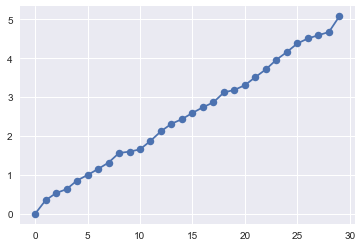

Number of neighbours : 30
jump : 1.40175649009,  position : 13


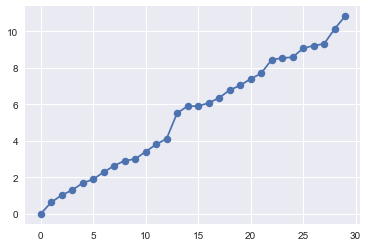

Number of neighbours : 50
jump : 3.50398013459,  position : 13


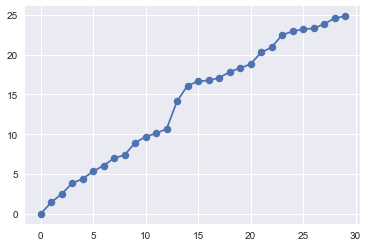

Number of neighbours : 70
jump : 3.65230413517,  position : 13


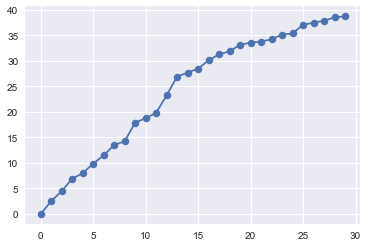

Number of neighbours : 80
jump : 4.87420505834,  position : 9


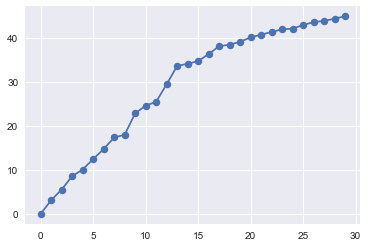

Number of neighbours : 100
jump : 6.8031389706,  position : 9


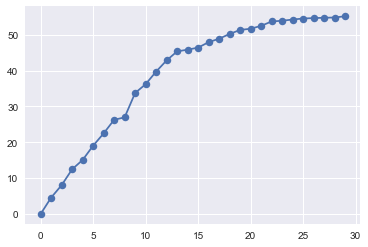

Number of neighbours : 120
jump : 7.75731491777,  position : 9


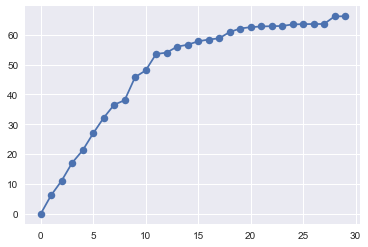

In [16]:
from scipy import sparse
n_neighbours_list = [20,30,50,70,80,100,120]

for n in n_neighbours_list:  
    set_neighbors_and_plot(n)

After running the grid search several times, we find that the best jump we get is with 100 neighbours. From the plots, we see that with a 100 neighbors we get a more significant jump at position 9 compared to all other jumps.
<br> It should be noted that this method is heuristic and should be taken with a grain of salt. We will find out later if selecting 100 neighbours per node and 9 clusters will give a good clustering.

Number of neighbours : 100
jump : 6.8031389706,  position : 9


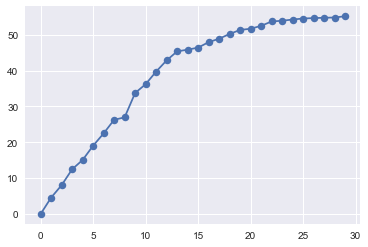

In [17]:
#Setting the number of neighbours to 100.
weights = set_neighbors_and_plot(100) 

Here, we finally perform spectral clustering with 9 clusters and 100 neighbours.

In [18]:
spectral = cluster.SpectralClustering(eigen_solver='arpack',affinity="precomputed",n_clusters=9)

#Predicting labels
y_pred=spectral.fit_predict(weights)

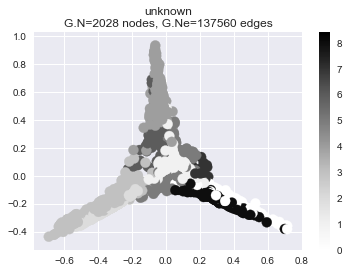

In [19]:
# Tentative visualization of clusters

G = graphs.Graph(weights)
G.estimate_lmax()
xx= manifold.spectral_embedding(G.W, n_components=2, eigen_solver=None, random_state=None, eigen_tol=0.0, norm_laplacian=True, drop_first=True)
G.set_coordinates(xx)

G.plot_signal(y_pred, backend='matplotlib')


## 3.2 Analyzing the clusters:

In this section, we will test how good our clustering performed. We will find the occurence of each category elements assigned in the beginning (section 1.3) with the clusters and see how they were separated.

### Calculating the occurences:

In [20]:
labels = np.arange(np.max(np.unique(y_pred))+1)
categories = np.unique(df['cat'])
occurence_matrix = np.zeros((len(labels),len(categories)))
df['cat']=df['cat'].astype(int)
for i in range(len(y_pred)) : 
    occurence_matrix[y_pred[i]][df['cat'][i]-1]+=1

### Vizualising the occurences : 

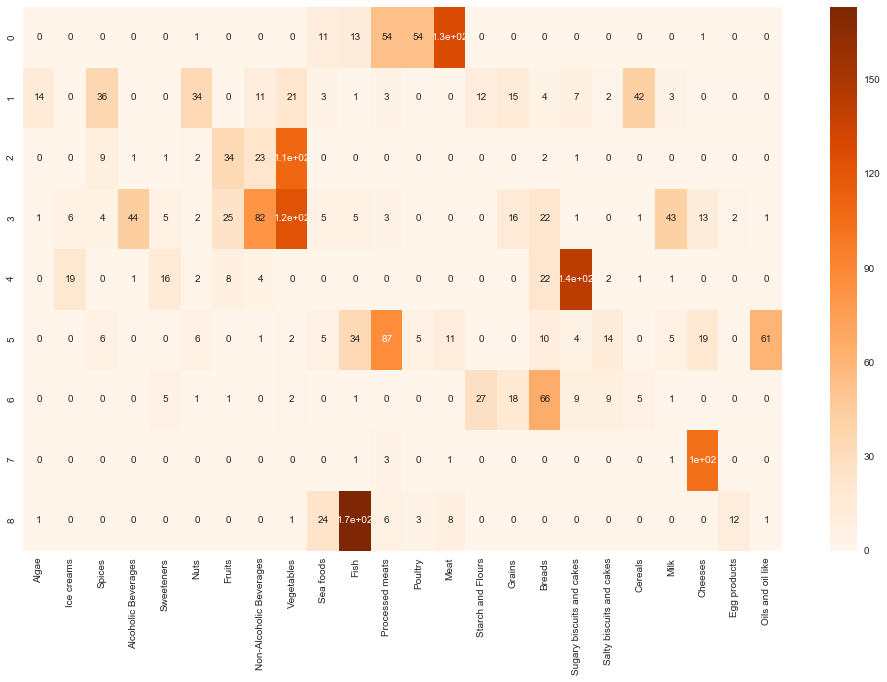

In [21]:
a4_dims = (17, 10)
fig, ax = plt.subplots(figsize=a4_dims)

plot = sns.heatmap(occurence_matrix,annot=True,cmap="Oranges")
plot.set_xticklabels(category_names,rotation = 90)

plt.show()

From the heatmap shown above, we can see that the clustering performed well. In fact, we can see that fruits and vegetables were clustered together. It is also the case for meats and poultry, Fish and sea-foods and so on...

Now we wish to see what features influenced each cluster the most.

### Analysis of each cluster : 

In this part, we exhaustively plotted bar plots of amounts of each feature per cluster to see which feature influenced which cluster the most.

In [22]:
def bar_plot(df, columns, categ,size):
    
    sns.set_style("whitegrid")
    fig, aux = plt.subplots(1, 1)
    
    fig.set_size_inches(size[0], size[1])
    fontsize = 14
    current_df = pd.DataFrame(columns= ["Node","Value","Category","Nutriment"])
    df_copy = pd.DataFrame(columns= df.columns)
    for curr_cat in categ:
        new_df = pd.DataFrame(df[df["cat"] == curr_cat])
        df_copy = pd.concat([df_copy,new_df])
    for i in columns:
        col = df_copy.columns[i]
        df_copy["Node"]= df_copy.index.values
        col_df = df_copy[["Node",col,"cat"]]
        col_df.columns = ["Node","Value","Category"]
        col_df["Nutriment"] = col
        current_df = pd.concat([current_df,col_df])
    current_df['Category']=current_df['Category'].apply(lambda x : category_names[int(x)-1])
    plt.ylabel("Value", fontsize=fontsize)
    plt.xlabel("Nutriment", fontsize=fontsize)
    sns.barplot(x="Nutriment", y="Value", hue="Category", data=current_df)
    
    
    plt.show()



#### Cluster 0 : 

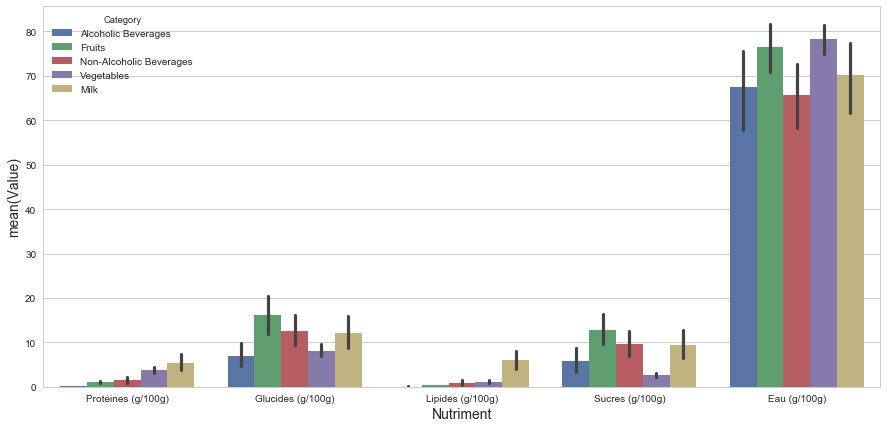

In [23]:
bar_plot(df,[9,11,12,13,8],[4,7,8,9,21],(15,7))

This cluster is mainly characterized by high amounts of sugar ,carbs and especially water.

#### Cluster 1 : 

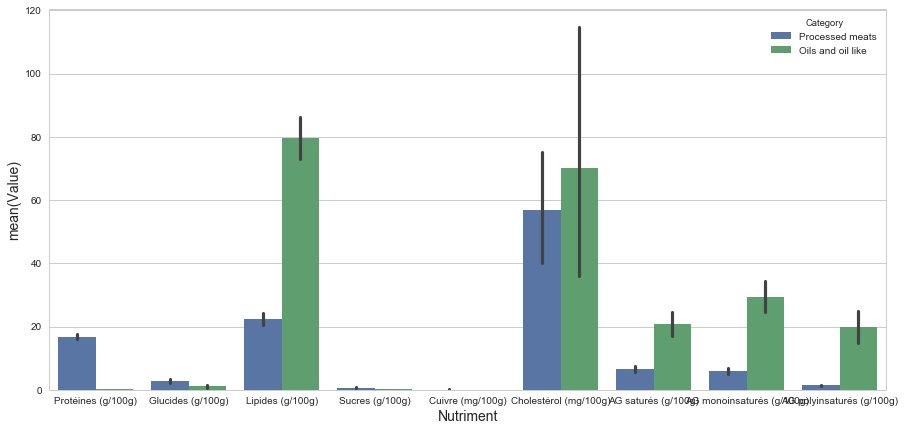

In [24]:
bar_plot(df,[9,11,12,13,41,37,20,21,22],[12,24],(15,7))

This cluster seems to contain ingredients with amounts of cholesterol and Fats of all kinds.

#### Cluster 2 : 

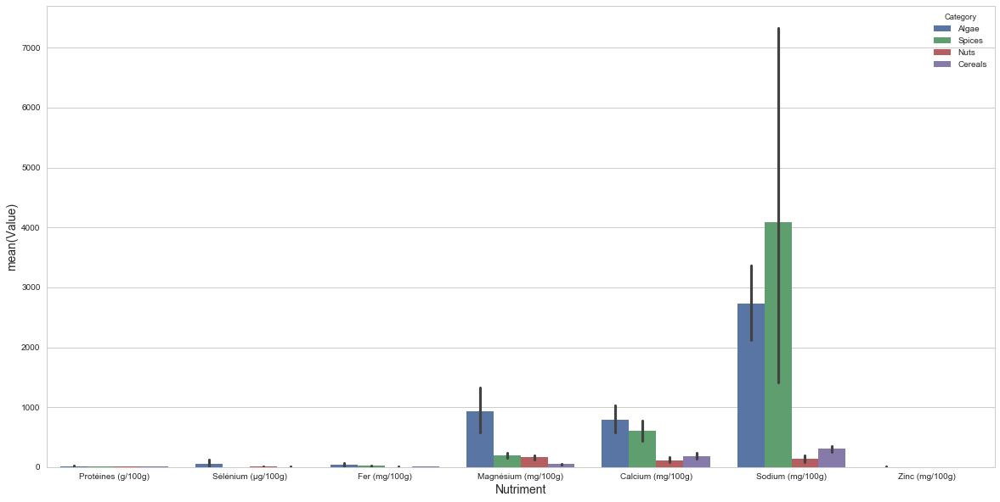

In [25]:
bar_plot(df,[9,48,42,44,39,49,50],[1,3,6,20],(20,10))

This cluster contains ingredients with high mineral contents, such as Sodium, Calcium Magnesium and low content in Protein in comparison.

#### Cluster 3 :

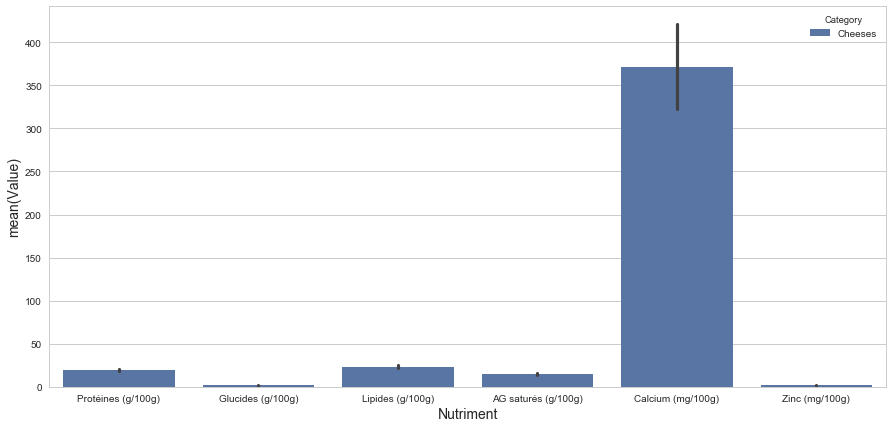

In [26]:
bar_plot(df,[9,11,12,20,39,50],[22],(15,7))

This cluster that contains only cheese is characterized by very high content in Calcium, and high amounts of Fats which seems to be almost entirely Saturated fat as well as a good amount of Protein.

#### Cluster 4 : 

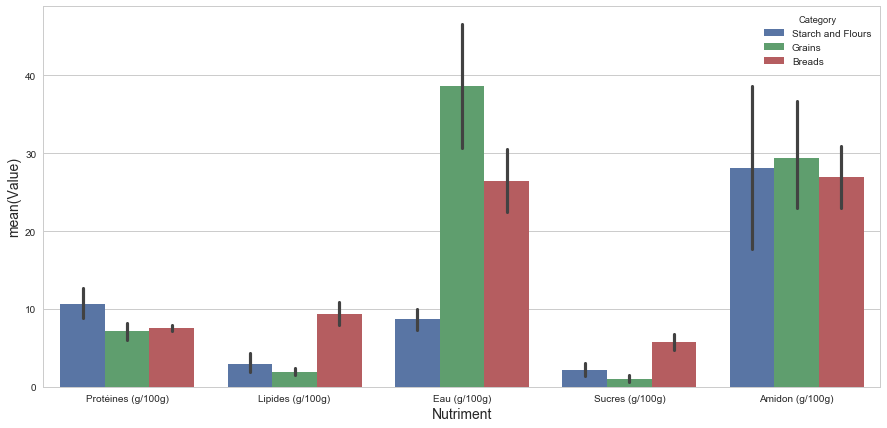

In [27]:
bar_plot(df,[9,12,8,13,14],[15,16,17],(15,7))

This cluster is characterized by considerable amount of water and very high amount of starch.

#### Cluster 5 : 

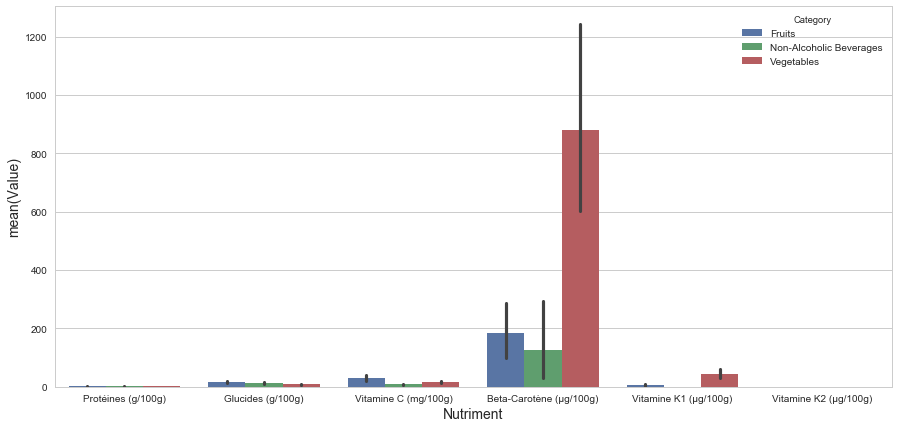

In [28]:
bar_plot(df,[9,11,57,52,55,56],[7,8,9],(15,7))

The elements of this cluster which are fruits, vegetables and Non-alcoholic beverages (which contain juices) contain high amounts of carbs, vitamins C and K1 and especially high amounts of Vitamin A (Beta-Carotene).
<br> It also contains low amounts of protein.

#### Cluster 6

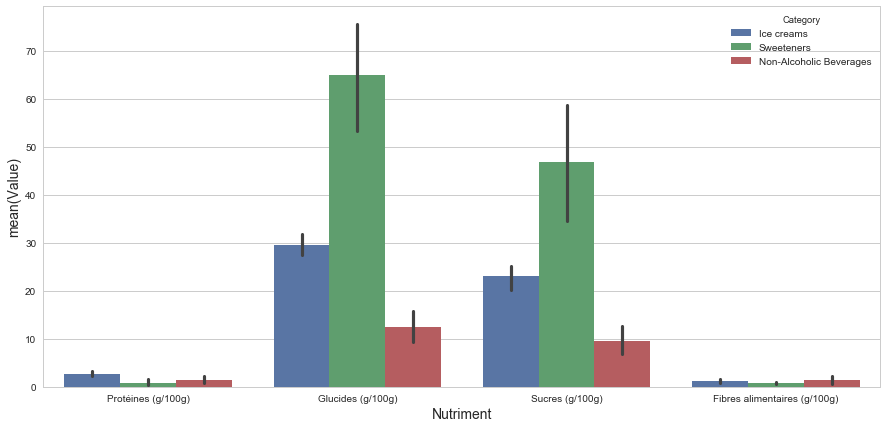

In [29]:
bar_plot(df,[9,11,13,15],[2,5,8],(15,7))

This cluster includes all sugary foods such as sweeteners (honey, sugar) , Ice cream and Non-alcoholic Beverages. These elements are characterized by high amounts of carbs which consist of almost entirely  sugar and has no fiber at all. It also has very low amounts of protein.

#### Cluster 7 : 

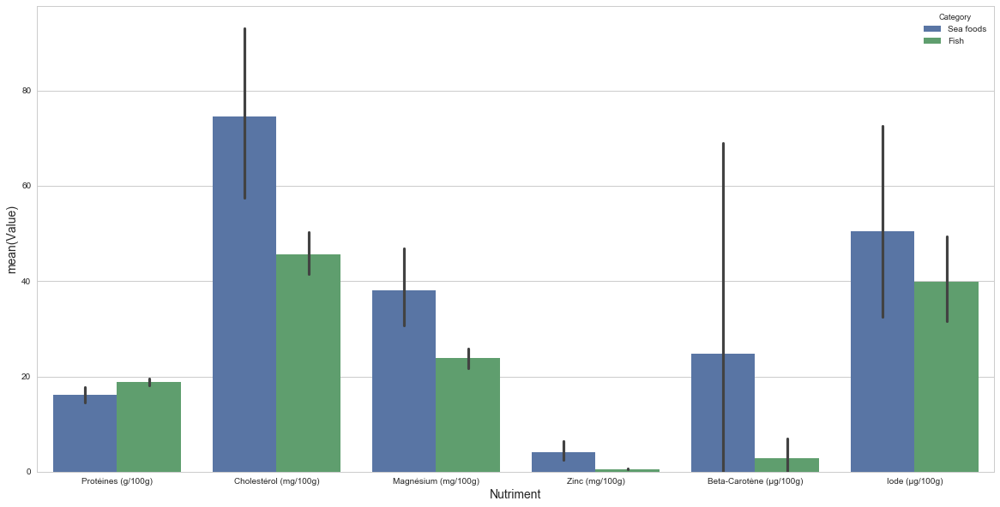

In [30]:
bar_plot(df,[9,37,44,50,52,43],[10,11],(20,10))

This cluster which contains Sea-foods and Fish has high content in Cholesterol and protein. Also, it has high amount of Zinc, Magnesium , and Vitamin A.

#### Cluster 8 : 

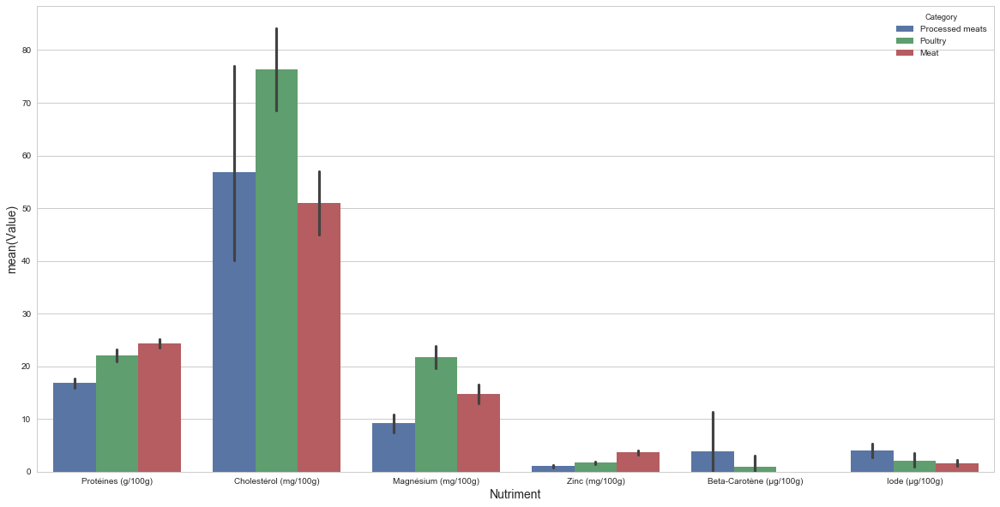

In [31]:
bar_plot(df,[9,37,44,50,52,43],[12,13,14],(20,10))

The foods in this cluster are red meats, poultry and processed meats. These foods are almost exactly like the Fish and sea-foods in the previous cluster in term of content. It is not clear to us how these two clusters were magically separated since they contain very similar characteristics including Cholesterol, Magnesium, Protein and Fat. <br>
The amount of fat seems to be a little higher in this cluster and that of Vitamin A is lower. However, the difference is not so big that it is clear to us how they were separated.

## 4.3 Visualizing clusters : 

We wanted to see the clusters better, so we wrote java script file and visualized the clusters as a graph.
<br> Note that, each category of food has a distinct color, hence, we can see the clusters and category distributions better.

All clusters


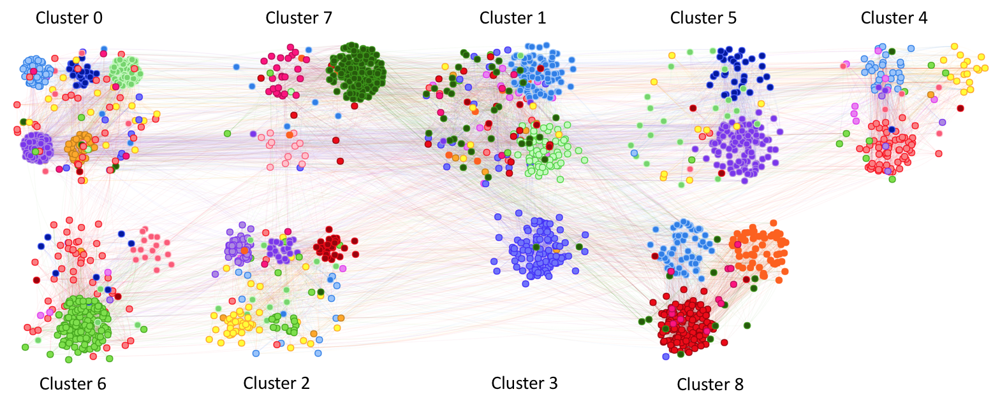

In [32]:
from IPython.display import Image

print("All clusters")
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
Image(filename = PATH + "All_clusters.png", width=1000, height=1000)


Cluster 0


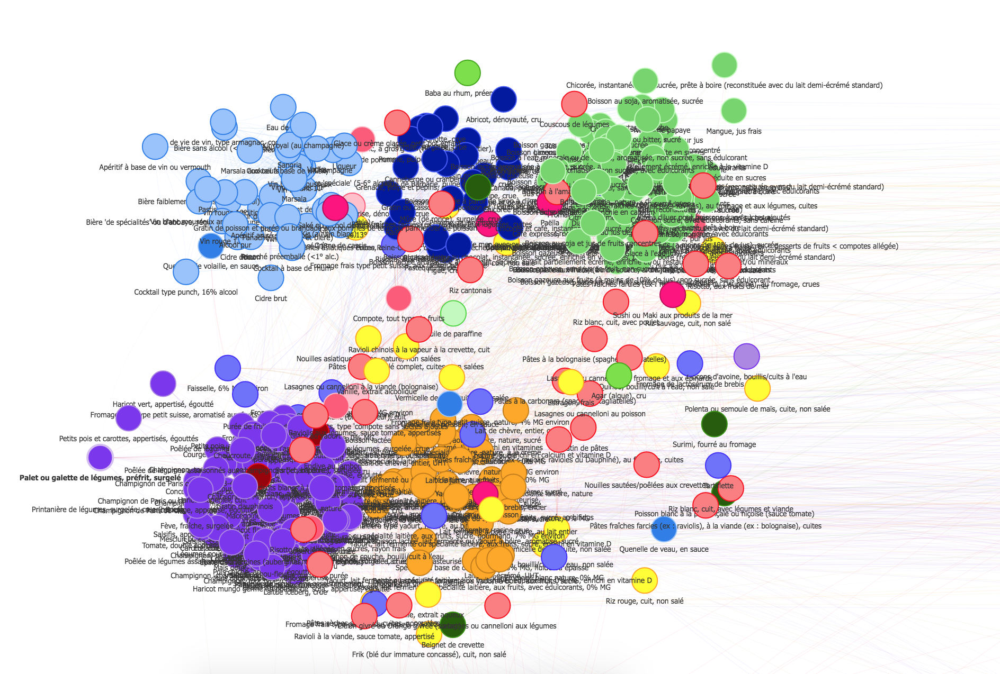

In [33]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(0))
Image(filename = PATH + "cluster"+str(0)+".png", width=1000, height=1000)


Cluster 1


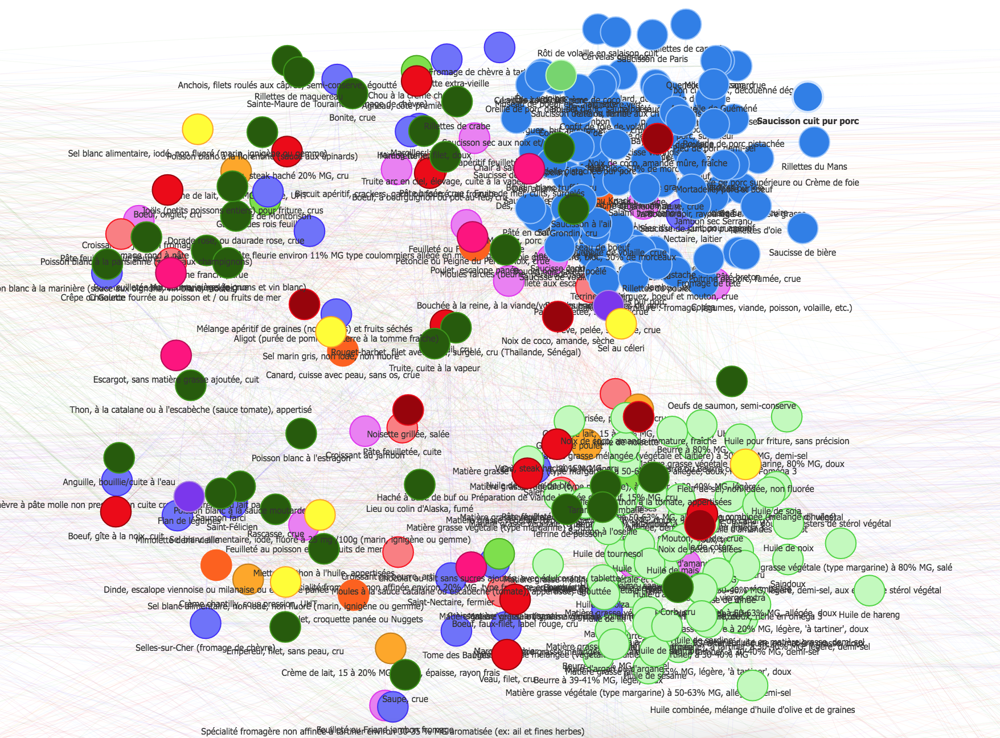

In [34]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(1))
Image(filename = PATH + "cluster"+str(2)+".png", width=1000, height=1000)


Cluster 2


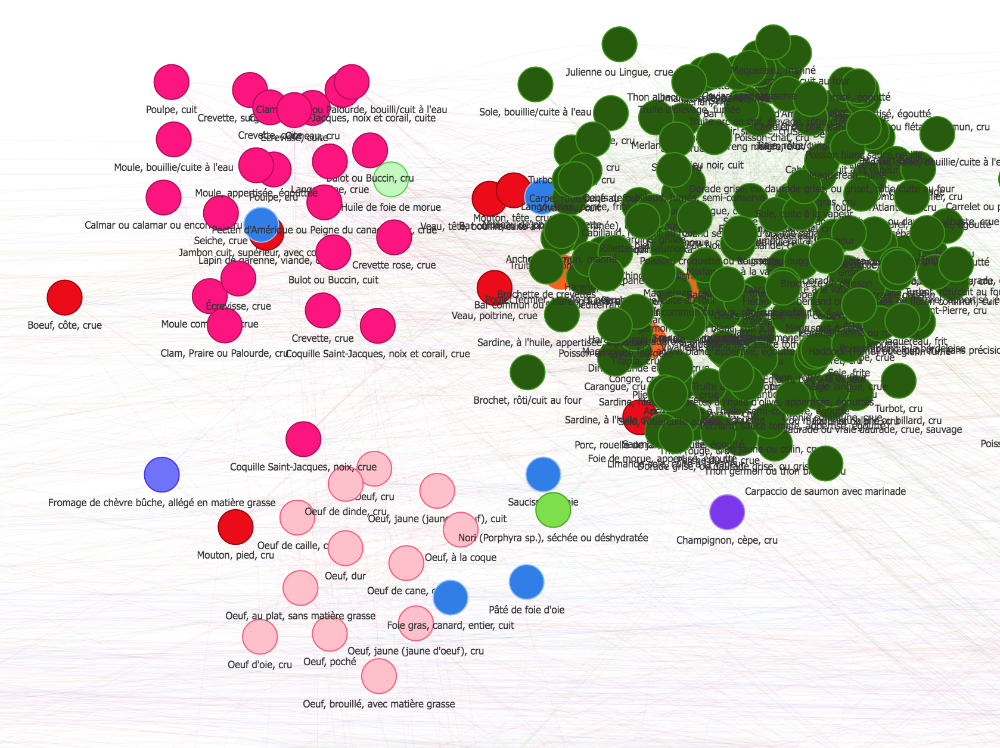

In [35]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(2))
Image(filename = PATH + "cluster"+str(1)+".png", width=1000, height=1000)


Cluster 3


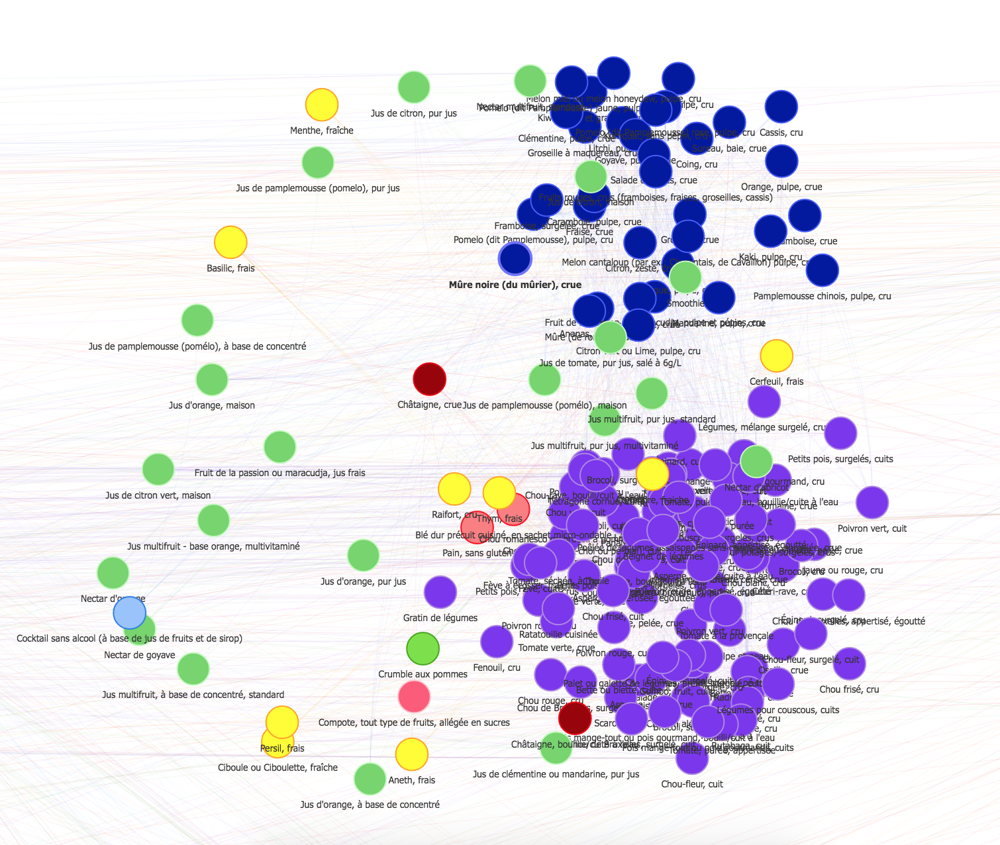

In [36]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(3))
Image(filename = PATH + "cluster"+str(3)+".png", width=1000, height=1000)


Cluster 4


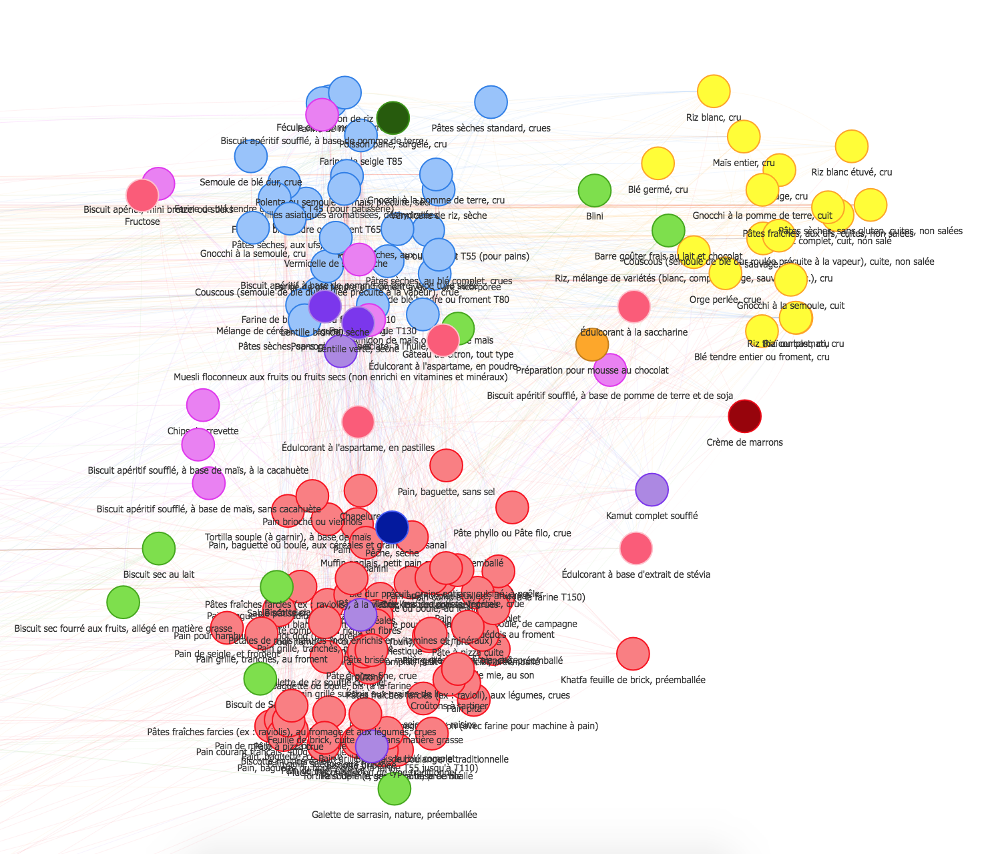

In [37]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(4))
Image(filename = PATH + "cluster"+str(4)+".png", width=1000, height=1000)


Cluster 5


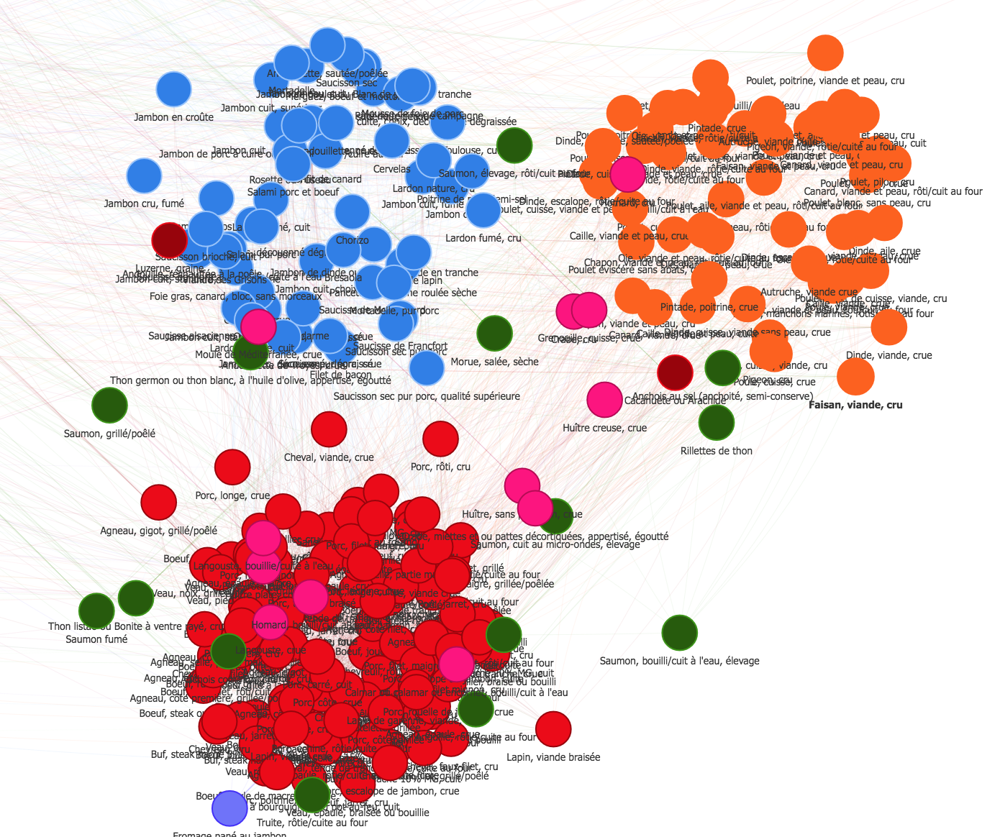

In [38]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(5))
Image(filename = PATH + "cluster"+str(5)+".png", width=1000, height=1000)


Cluster 6


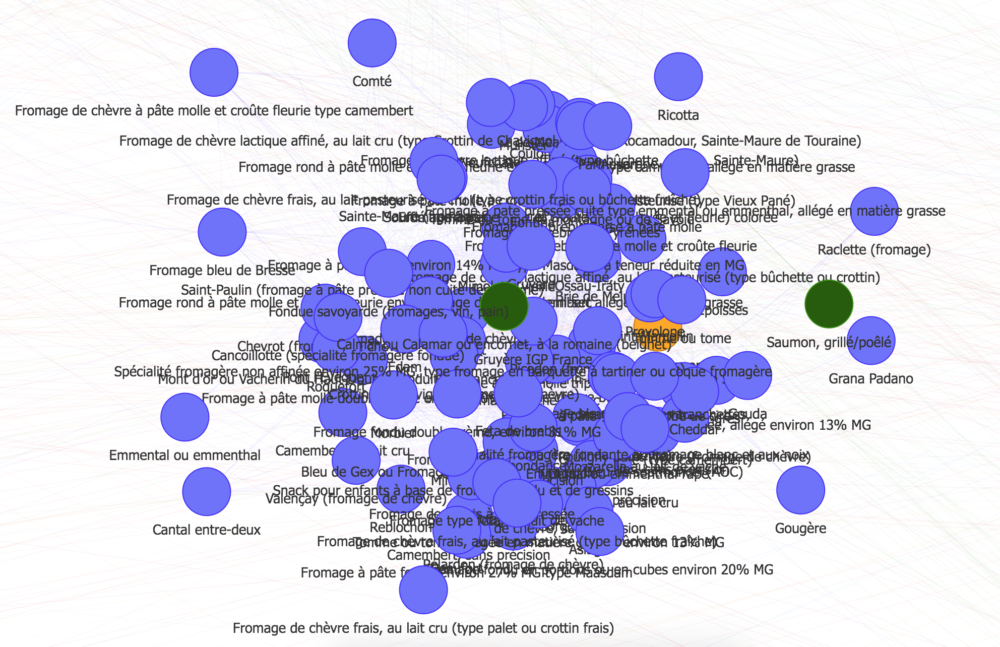

In [39]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(6))
Image(filename = PATH + "cluster"+str(6)+".png", width=1000, height=1000)


Cluster 7


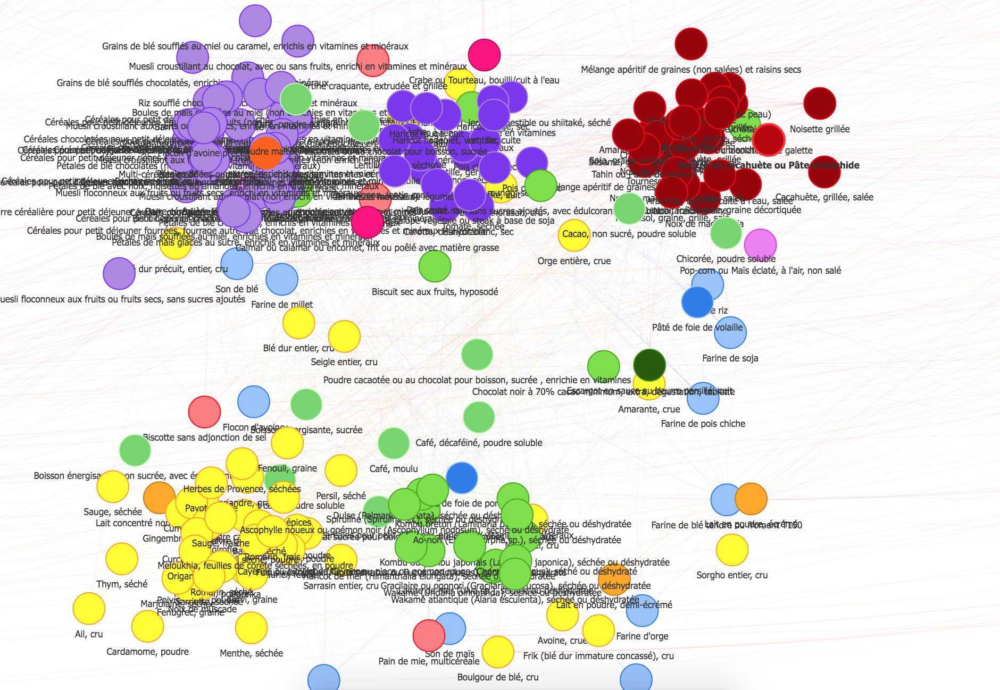

In [40]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(7))
Image(filename = PATH + "cluster"+str(7)+".png", width=1000, height=1000)


Cluster 8


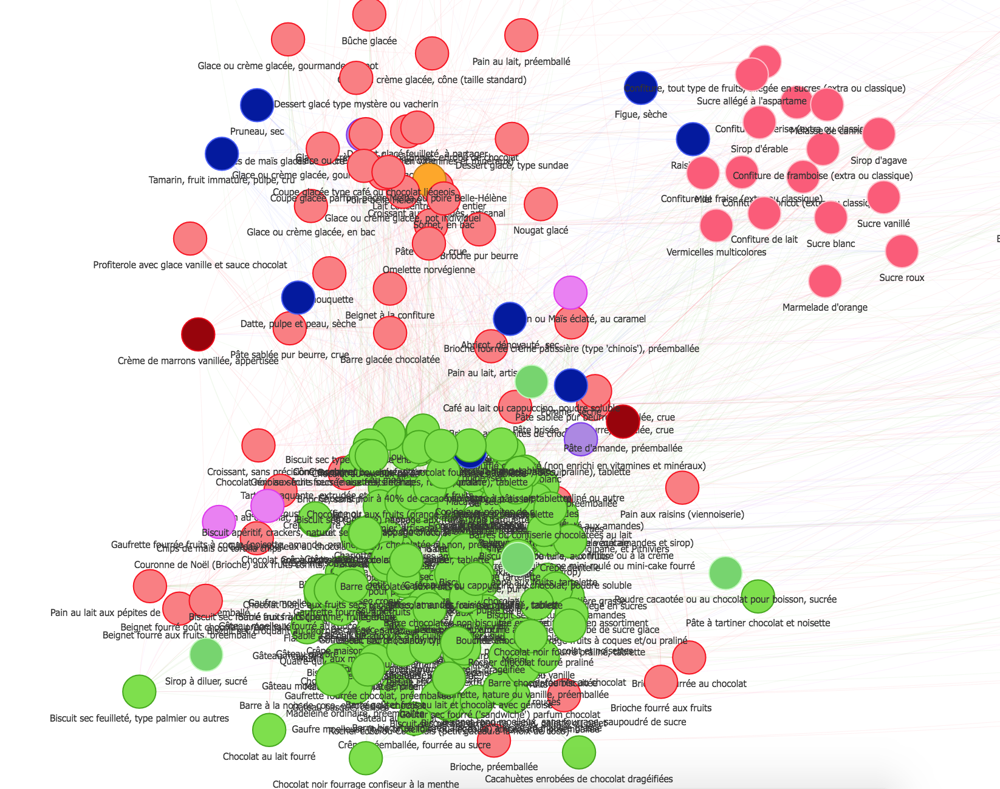

In [41]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/clusters/"
print("Cluster "+ str(8))
Image(filename = PATH + "cluster"+str(8)+".png", width=1000, height=1000)


## 4.4 Showing feature presence in graph : 

In addition to showing clusters and analyzing what made them differ, we decided to put our conclusions to the test. We showed the intensity of many features across the graph. (The darker the shade of blue the more intense) 

### Water :

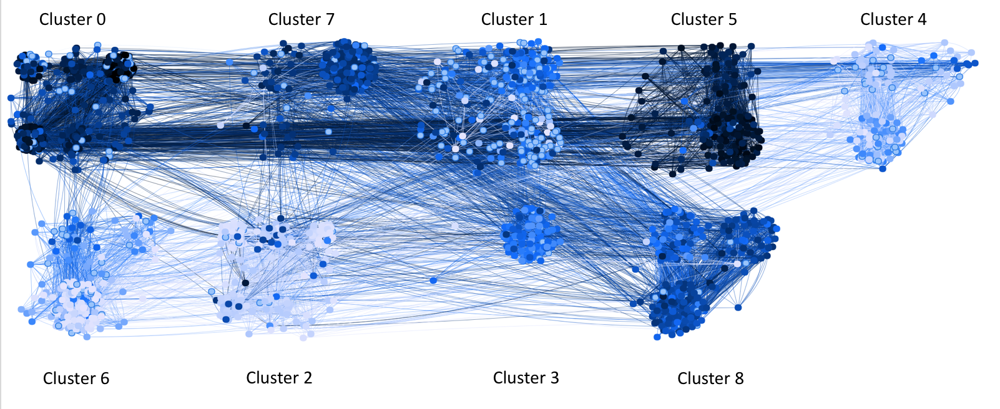

In [42]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "eau.png", width=1000, height=1000)

If we refer to our previous images, we see that water content is present mostly in milk products and beverages.

### Protein: 

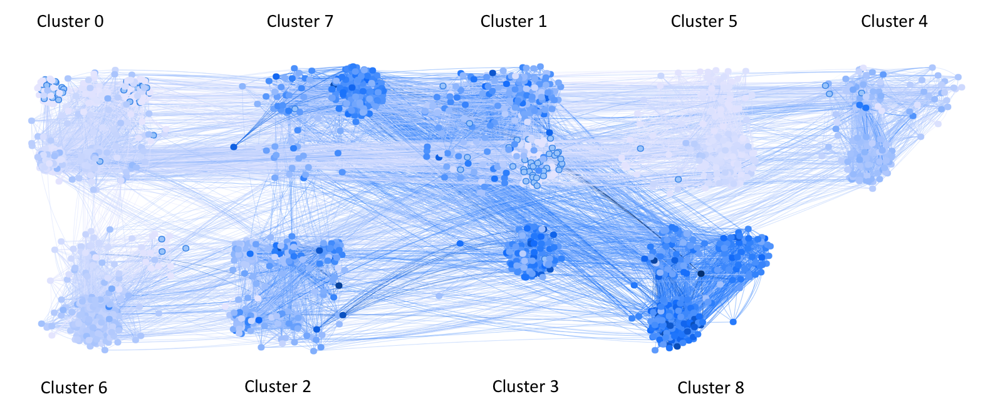

In [43]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "proteine.png", width=1000, height=1000)

Protein is mostly present in meats, poultry, fish and Cheese.

### Cholesterol : 

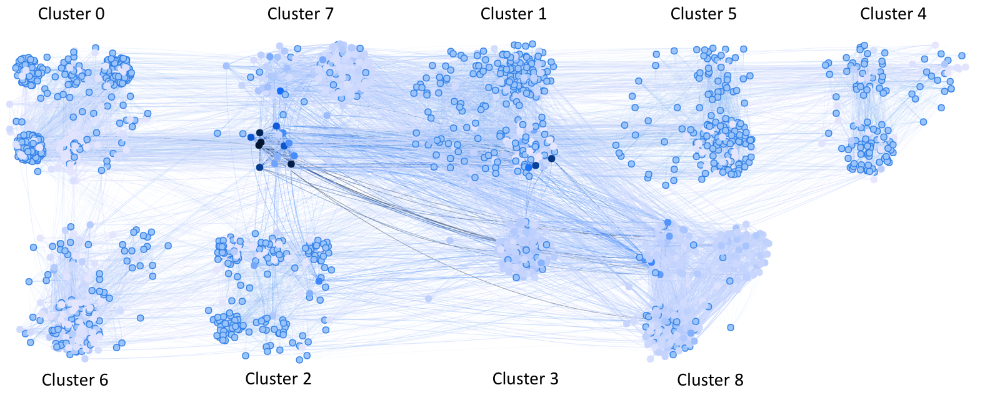

In [44]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "cholesterol.png", width=1000, height=1000)

Cholesterol is mostly present in Oils, fish and sea-foods.

### Magnesium: 

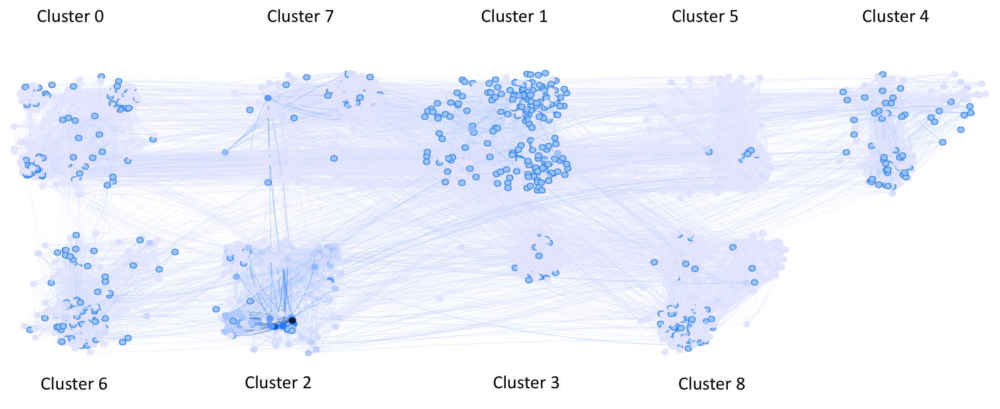

In [45]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "magnesium.png", width=1000, height=1000)

### Sodium: 

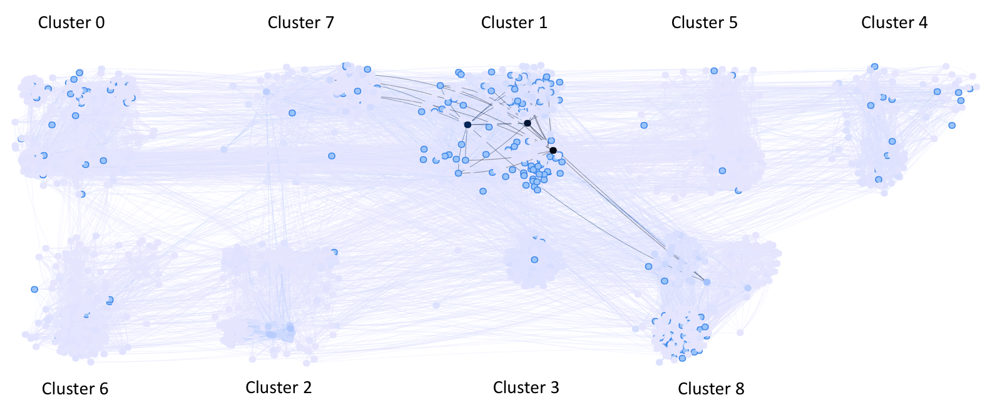

In [46]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "sodium.png", width=1000, height=1000)

Sodium is present in processed meats, fish and sea-foods.

### Sugar : 

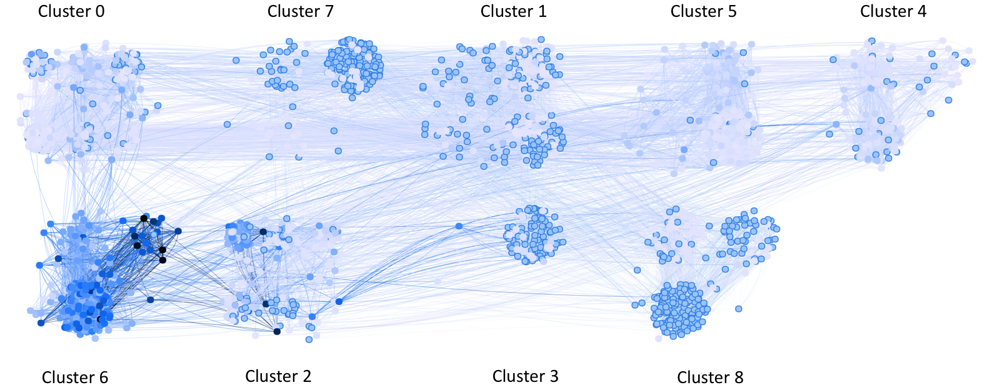

In [47]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "sucre.png", width=1000, height=1000)

### Iodine : 

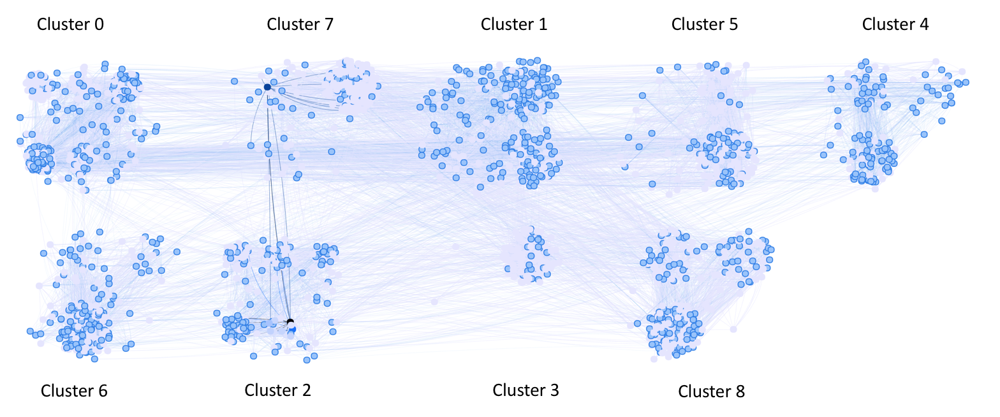

In [48]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "iode.png", width=1000, height=1000)

### Calcium:

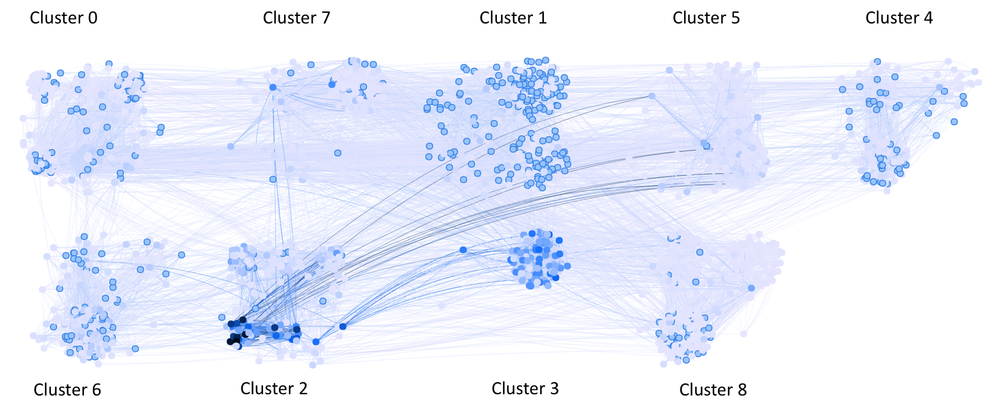

In [49]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "calcium.png", width=1000, height=1000)

Calcium is present in milk, Cheese and Greens.

### Saturated fat : 

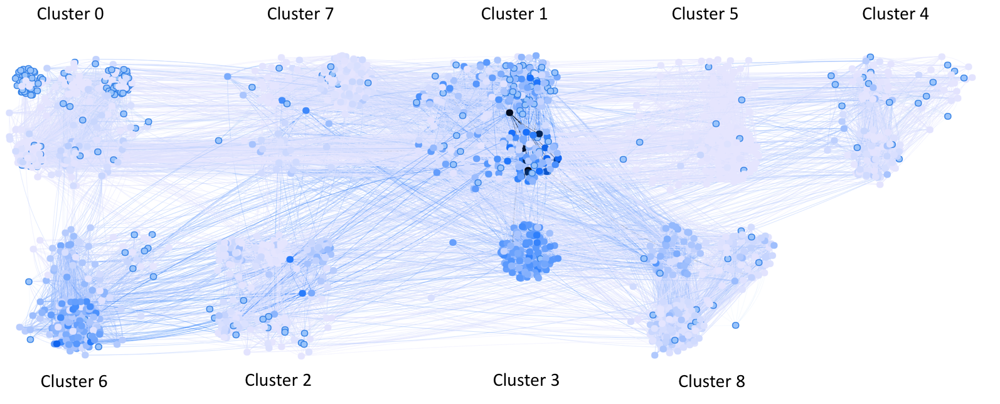

In [50]:
PATH = "/Users/firasbenothman/Desktop/ntds_project/signals/"
Image(filename = PATH + "acide_gras_sature.png", width=1000, height=1000)

Saturated fat is present in oils, meats and Fish.

# 5. Feature correlations:

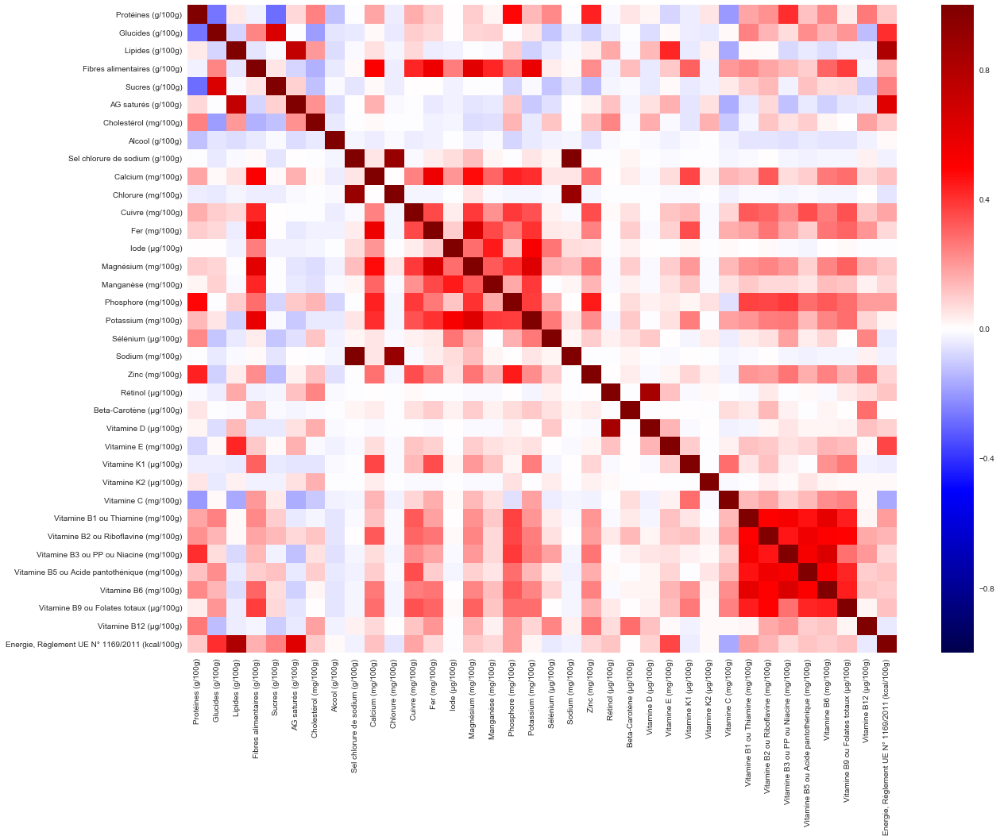

In [51]:
columns.append('Energie, Règlement UE N° 1169/2011 (kcal/100g)')
correlation = df[columns[2:]].corr()
a4_dims = (20, 15)
fig, ax = plt.subplots(figsize=a4_dims)
#ax.xticks(rotation=45) 
sns.heatmap(correlation,cmap="seismic")

- We can see that there's a strong correlation between Fat content and calories, which makes sens because 1 gram of lipids has 9 calories. On the other hand one gram of protein or carb has only 4 calories which explain the smaller correlation in the correlation matrix.
- Also, some minerals such as Potassium, Iron and Magnesium are positively correlated with Fiber content per 100 grams. This suggests that these minerals are likely present with foods that are high in Fiber.
- The correlation between Fiber and Carbs is positive but small, this is surprising because Fibers are usually present with some carbs. This may be due to the presence of many foods that contain added sugar.
- A lot of the B vitamins are strongly correlated with each other, which means that they are likely to be present together as a package. 
- A lot of the minerals (Iron, Iodine, Magnesium, Manganese, Calcium, Phosphore ...) are positively correlated with each other. This also means that these mineral are present together in foods.
- Sodium and Chlorine are very correlated with salt, this is no surprise because salt is composed of one atom of Chlorine and one atom of Sodium (NaCl).
- Cholesterol is positively correlated with lipids, which is surely due to the presence of Cholesterol along with animal fats.
- Protein is negatively correlated with carbs and positively correlated with Fat. This could be explained by the presence of Protein in meats, fish as well as nuts and seeds along with Fat. However, these correlations are not strong since there are a lot of products that contain significant amounts of carbs and protein, namely, legumes (lentils, chickpeas, beans...). In addition, There are many fatty foods that do not contain a significant amount of protein (fries, avocados, oils...).

# 6. Code for website : 

In this section, we create a json file based on our graph. The file will then be used to create the graph on our website and give us the visualizations shown above.

In [52]:
def return_json_file(dataframe):
    """
    Returns an edge list ready to be read and used as a graph.
    :param dataframe: DataFrame
    :return: edge list in string format
    """
    
    edge_list='{\n\t"nodes": [\n'
    for food_index in dataframe.index:
        
        food=dataframe.loc[food_index]
        if(food_index==max(dataframe.index)) : 
            edge_list+='\t{"id" : '+ str(food_index) + ',"label" : "' + dataframe['ORIGFDNM'][food_index].replace('"',"'") +  '", "group":'+str(dataframe['cat'][food_index])+'}\n],\n\t"edges":[\n'
        else : 
            edge_list+='\t{"id" : '+ str(food_index) + ',"label" : "' + dataframe['ORIGFDNM'][food_index].replace('"',"'") +  '", "group":'+str(dataframe['cat'][food_index])+'},\n'
        
        #Iterating over all foods
        
        
    for i in dataframe.index : 
        
        nodes = np.argsort(weights[i])[-11:-1]
        
        for node in range(len(nodes)) :
            if(node==len(nodes)-1 and i ==max(dataframe.index)): 
                edge_list+='\t{"from": '+str(i)+', "to": '+str(nodes[node])+'}\n\t]\n}'
            else :
                edge_list+='\t{"from": '+str(i)+', "to": '+str(nodes[node])+'},\n'            
    
    return edge_list

In [53]:
import math
from random import uniform, randrange
import json
from random import random

def translate_range(range_,vector,alpha):
    center = get_center(range_)
    x_new_center = center[0]+ alpha*vector[0]
    y_new_center = center[1]+ alpha*vector[1]
    hight_x = (range_[0][1]-range_[0][0])/2
    hight_y = (range_[1][1]-range_[1][0])/2
    new_x_range = [x_new_center-hight_x,x_new_center+hight_x]
    new_y_range = [y_new_center-hight_y,y_new_center+hight_y]
    return [new_x_range,new_y_range]

def get_ranges (num_clusters,x_max,y_max,origin):
    thresh_x = (float) (x_max)/5
    thresh_y = (float) (y_max)/7
    #thresh_x = 0
    #thresh_y = 0
    current_x = origin[0]-2*x_max
    current_y = origin[1]-2*y_max
    range_x = 4*((float)(x_max))/num_clusters
    range_y = y_max
    num_columns = math.ceil(float (num_clusters)/2)
    ranges = []
    for j in np.arange(2):
        current_y = current_y+range_y
        current_x = origin[0]-2*x_max
        for i in np.arange (num_columns):
            current_x = current_x+range_x
            ranges.append([[current_x,current_x+range_x-thresh_x],[current_y,current_y+range_y-thresh_y]])
    return ranges[:num_clusters]

def get_center(range_):
    return [np.mean(range_[0]),np.mean(range_[1])]

def getRandomPointInCircle(radius,center):
    t = 2 * math.pi * random()
    u = random() + random()
    r = None

    if u > 1:
        r = 2 - u
    else:
        r = u

    result = [center[0]+(radius * r * math.cos(t)), center[1]+(radius * r * math.sin(t))]
    return result

def get_coordinates_from_range(range_,circular=False,reduce=1):
    x_min = range_[0][0]
    x_max = range_[0][1] 
    y_min = range_[1][0]
    y_max = range_[1][1]
    if circular:
        radius = reduce*(min ([0.5*(x_max-x_min)],[0.5*(y_max-y_min)])[0])
        return getRandomPointInCircle(radius,get_center(range_))     
    else: 
        return [round(uniform(x_min, x_max),5),round(uniform(y_min, y_max),5)]

def spatial_cluster(data,numClusters,x_max,y_max,y_pred,dict_clusters):
    def get_clster_for_node (node_id,y_pred):
        return (int) (y_pred[node_id])
    
    ranges = get_ranges (numClusters,x_max,y_max,[0,0])
    for node in data["nodes"]:
        cluster = get_clster_for_node(node["id"],y_pred)
        range_ = ranges[cluster]
        x_range = range_[0]
        y_range = range_[1]
        cat = node["group"]
        list_cat = dict_clusters[cluster]
        if cat not in list_cat:
            coordinates = get_coordinates_from_range(range_,circular=True,reduce=1.3)
        else:
            index = list_cat.index(cat)
            center = get_center(range_)
            x_max = x_range[1] - center[0]
            y_max = y_range[1] - center[1]
            bins= len(list_cat)
            sub_ranges = get_ranges (bins,x_max,y_max,center)
            coordinates = get_coordinates_from_range(sub_ranges[index],circular=True,reduce=0.9)
             
        node["x"]= coordinates[0]
        node["y"]= coordinates[1]
    return data

def plot_signal(signal,data,colors):
    import sys
    EPSILON = sys.float_info.epsilon 
    def convert_to_rgba(minval, maxval, val, colors):
        fi = float(val-minval) / float(maxval-minval) * (len(colors)-1)
        i = int(fi)
        f = fi - i
        if f < EPSILON:
            return colors[i]
        else:
            (r1, g1, b1), (r2, g2, b2) = colors[i], colors[i+1]
            return "rgba({},{},{},1)".format(int(r1 + f*(r2-r1)), int(g1 + f*(g2-g1)), int(b1 + f*(b2-b1)))
    
    for node in data["nodes"]:
        id_ = node["id"]
        if "group"in node:
            del node["group"]
        node["color"]= convert_to_rgba(min(signal), max(signal), signal[id_], colors)   
    return data

num_clusters = 9
dict_clusters={0:[4,7,8,9,21],2:[12,24],6:[20,9,6,3,1],7:[22,16],4:[15,16,17],3:[7,9],5:[2,5,18],1:[10,11,23],8:[12,13,14]}
data=json.loads(return_json_file(df))
data= spatial_cluster(data,num_clusters,10000,4000,y_pred,dict_clusters)
with open('category.json', 'w') as outfile:
    json.dump(data, outfile)
calcium = list(df[df.columns[39]])
magnesium = list(df[df.columns[44]])
sodium = list(df[df.columns[49]])
protein = list(df[df.columns[9]])
acides_gras = list(df[df.columns[20]])
sucres = list(df[df.columns[13]])
eau = list(df[df.columns[8]])
cholest = list(df[df.columns[37]])
iode = list(df[df.columns[43]])
colors = [(230, 230, 255),(0, 102, 255),(0, 0, 0)]
data = plot_signal(iode,data,colors)
with open('category.json', 'w') as outfile:
    json.dump(data, outfile)